# Comparison of our Pipeline vs. Nicolas' Preprocessed Data

In [1]:
import pywt
import numpy as np
import matplotlib.pyplot as plt
import cPickle as pkl
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import cufflinks as cf
import sys
sys.path
sys.path.append('../..')
import methods
from methods.denoise import (rpca_denoise,
                             eog_split,
                             eog_regress,
                             bandstop,
                             highpass)
from methods.viz import sparklines, chan_errs
with open('../../../data/sub-0001_trial-01.pkl', 'rb') as f_handle:
    RAW = pkl.load(f_handle)
    RAW = RAW - np.mean(RAW, axis = 1).reshape(-1, 1)
with open('../../../data/sub-0001_trial-01_pre.pkl', 'rb') as f_handle:
    PRE = pkl.load(f_handle)
    PRE = PRE - np.mean(PRE, axis = 1).reshape(-1, 1)
with open('../../../data/sub-0001_trial-01_bc.pkl', 'rb') as f_handle:
    bc = pkl.load(f_handle)
def plot_heat(M, title):
    plt.figure(figsize=(16, 8))
    sns.heatmap(M, square=False, xticklabels = 2 + int(M.shape[1] / 20), yticklabels = 2 + int(M.shape[0] / 20))
    plt.tight_layout()
    plt.title(title)
    plt.show()

### Pre Pre-processing comparison

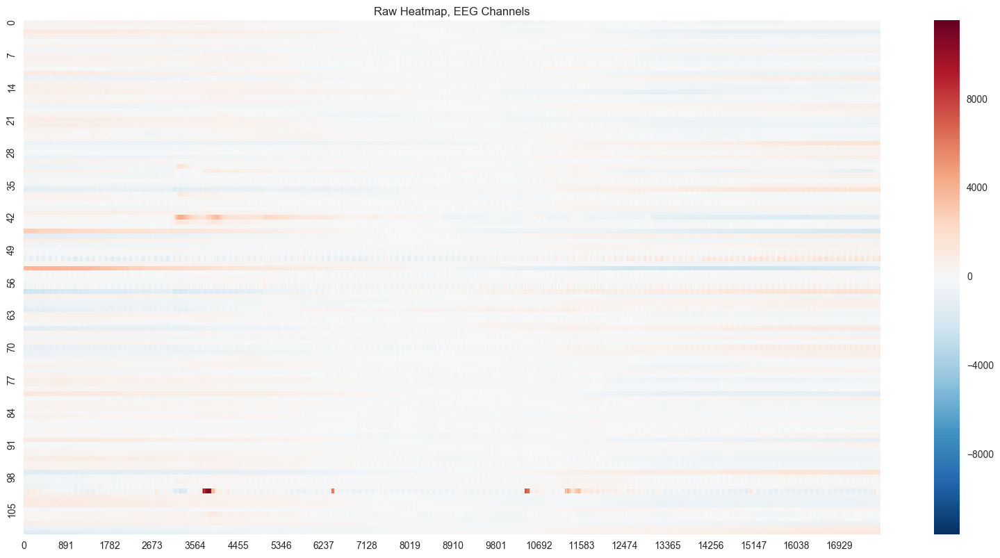

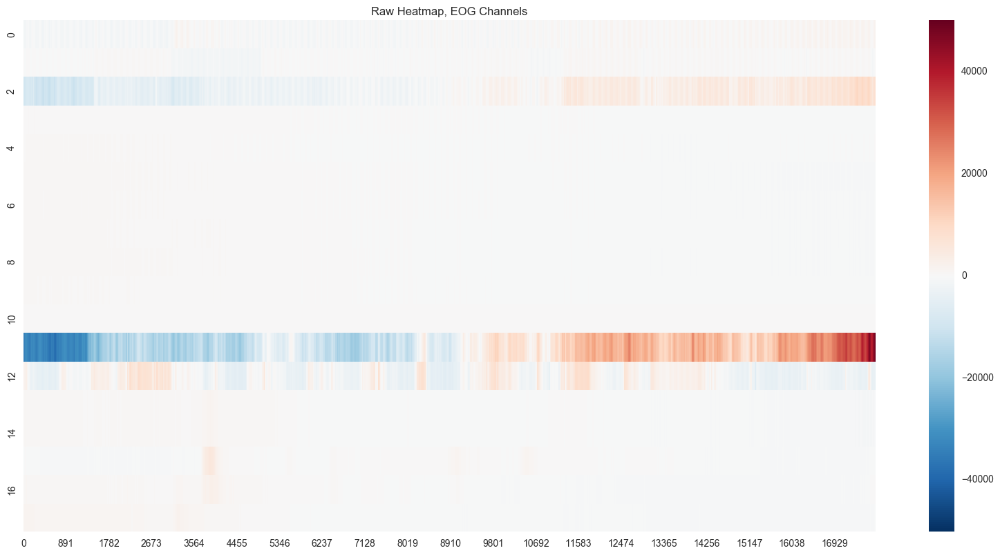

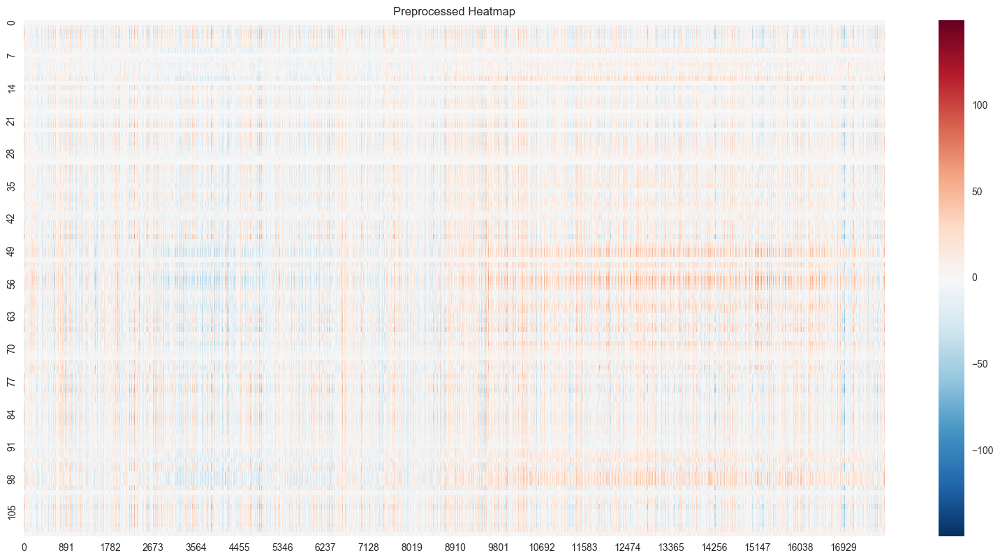

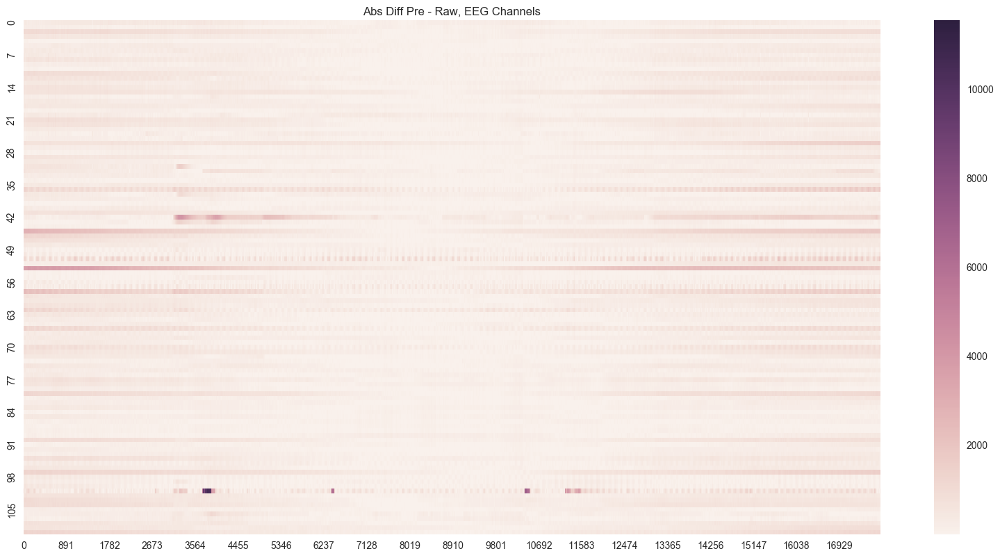

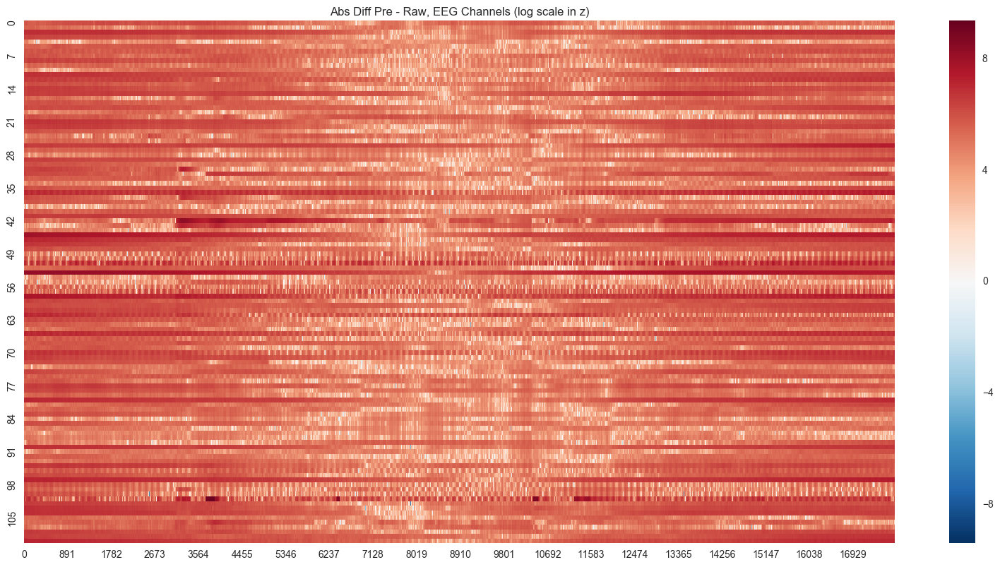

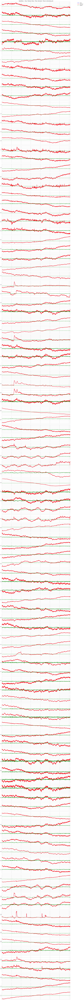

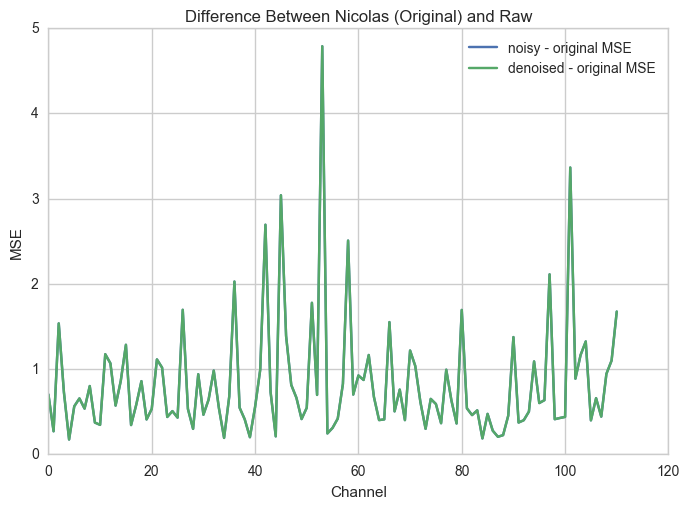

In [2]:
RAW_EEG, RAW_EOG = eog_split(RAW, {}, {})
RAW_EEG_ORIG = RAW_EEG
plot_heat(RAW_EEG[:, ::10], 'Raw Heatmap, EEG Channels')
plot_heat(RAW_EOG[:, ::10], 'Raw Heatmap, EOG Channels')
plot_heat(PRE[:, ::10], 'Preprocessed Heatmap')
plot_heat(np.abs(PRE[:, ::10] - RAW_EEG[:, ::10]), 'Abs Diff Pre - Raw, EEG Channels')
plot_heat(np.log(np.abs(PRE[:, ::10] - RAW_EEG[:, ::10])), 'Abs Diff Pre - Raw, EEG Channels (log scale in z)')
sparklines(PRE[:, ::50], RAW_EEG_ORIG[:, ::50], RAW_EEG[:, ::50], 'Sparklines -- Orig = Nicolas, Noisy = Raw, Denoised = Raw (no denoising yet)')
plt.show()
chan_errs(PRE, RAW_EEG, RAW_EEG, 'Difference Between Nicolas (Original) and Raw')
plt.show()

### 1. Highpass Filter at .1 Hz

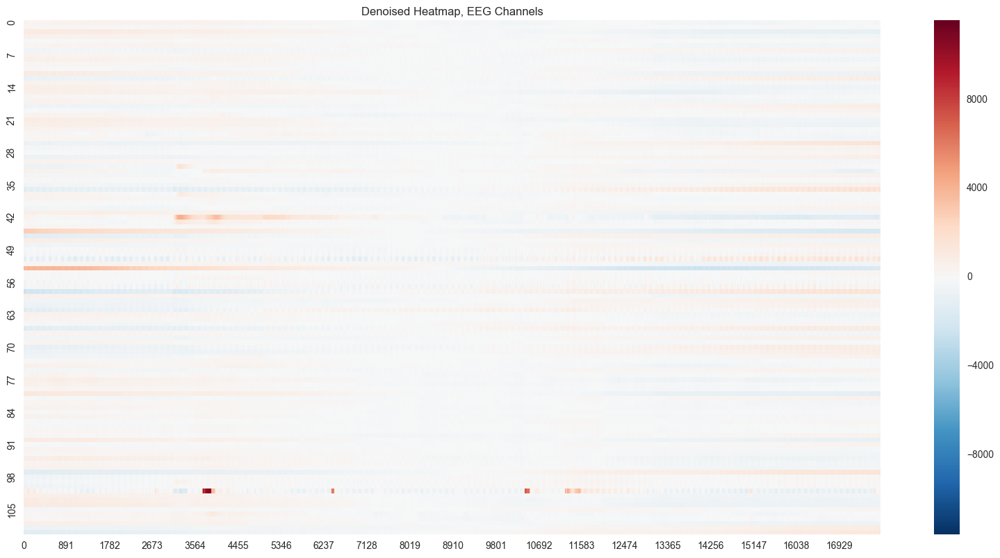

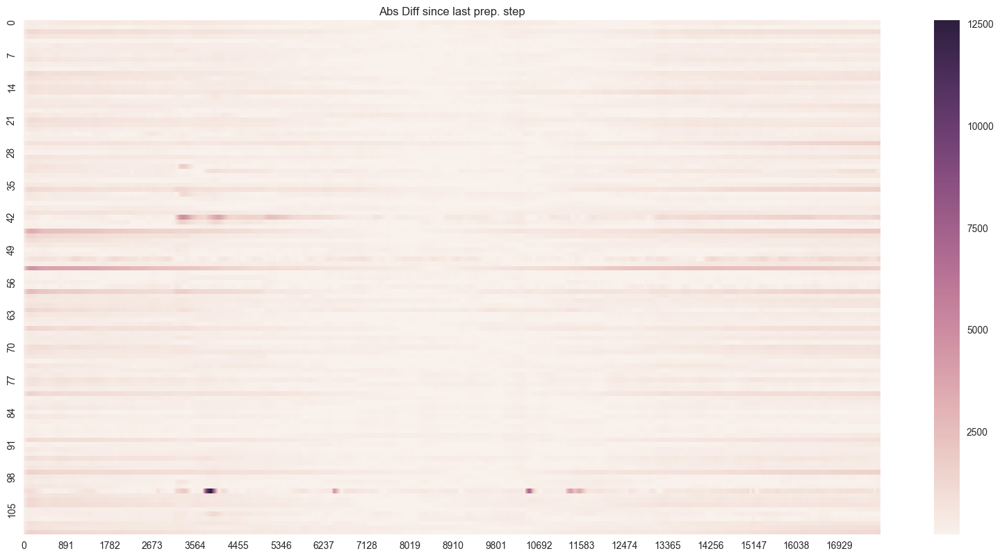

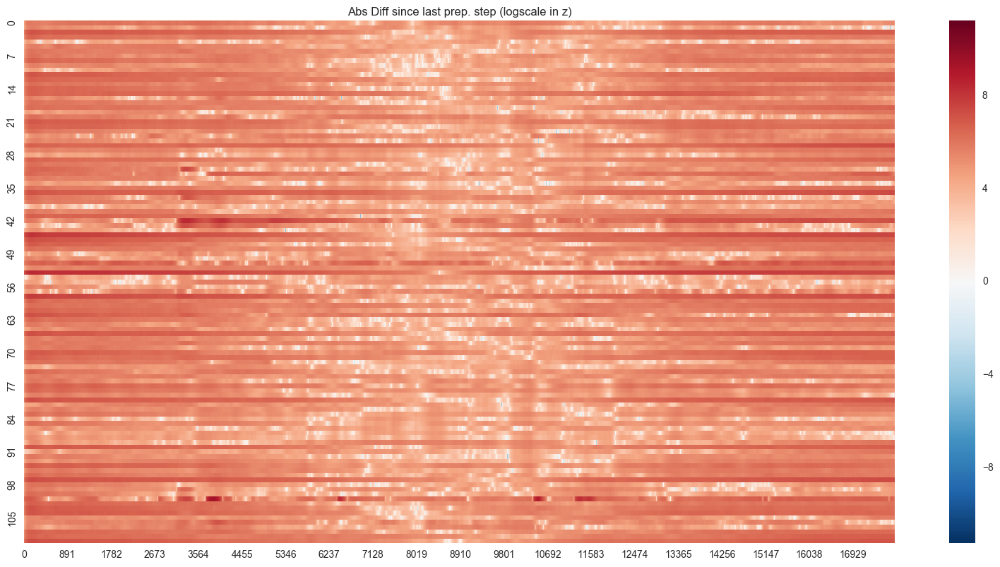

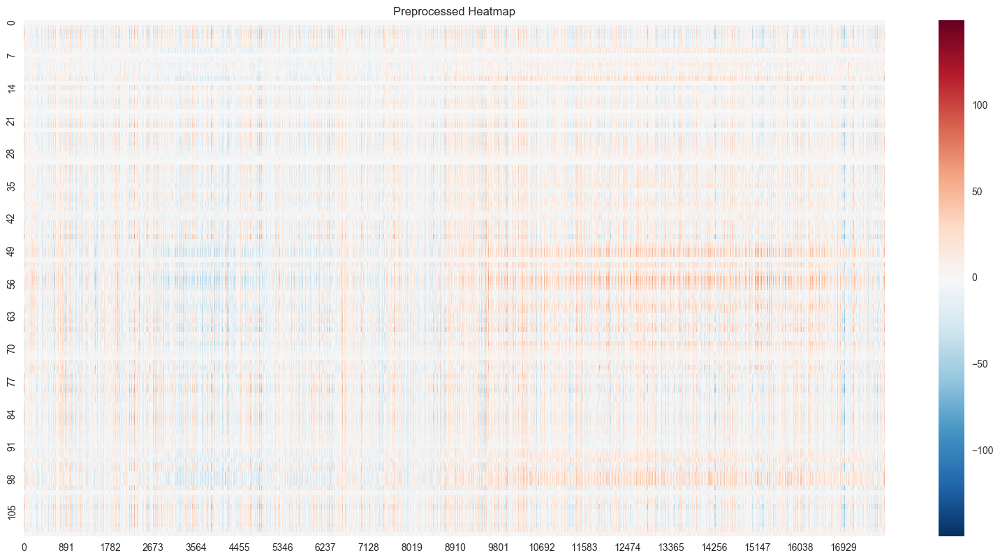

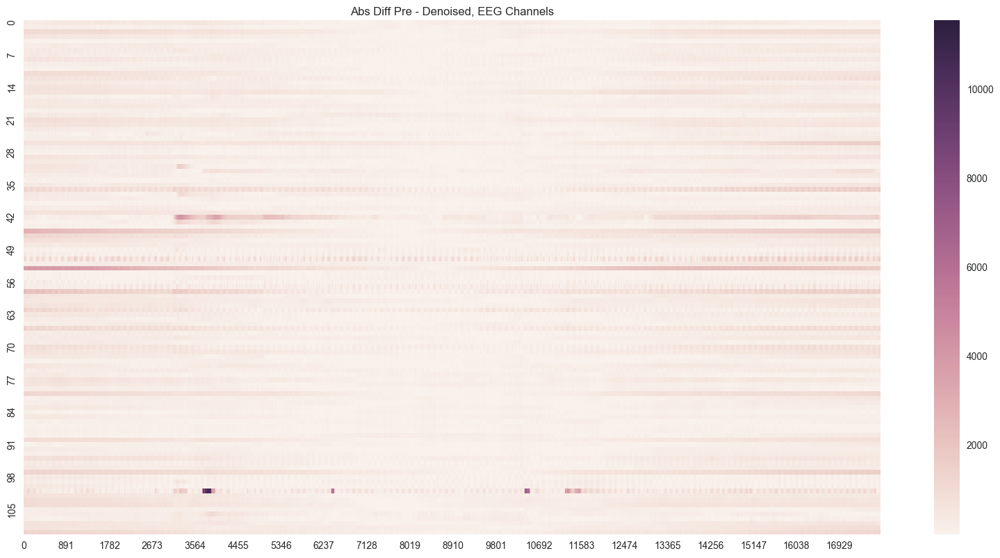

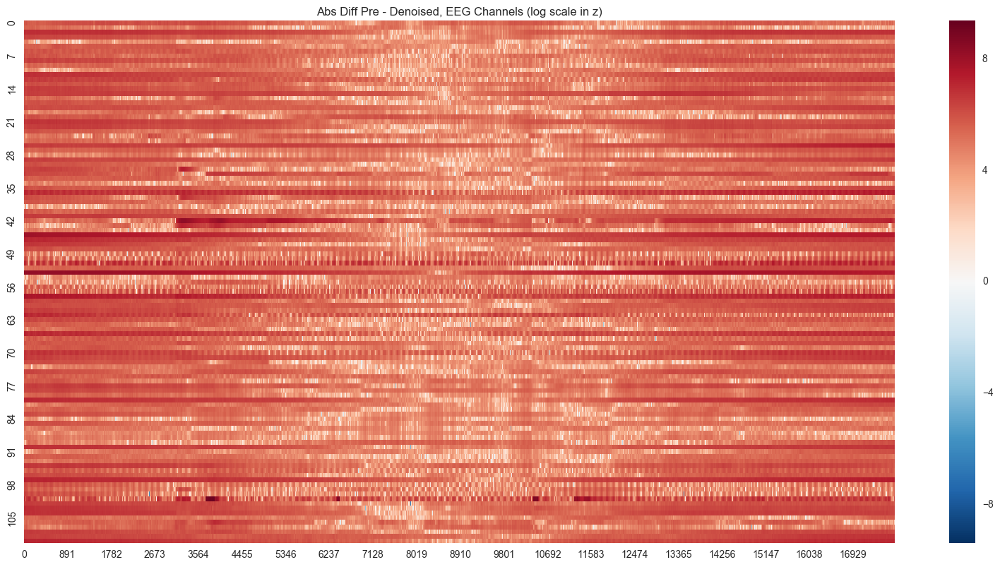

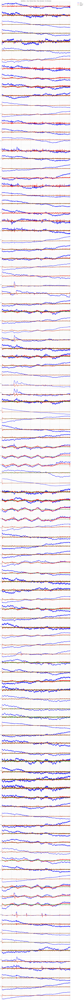

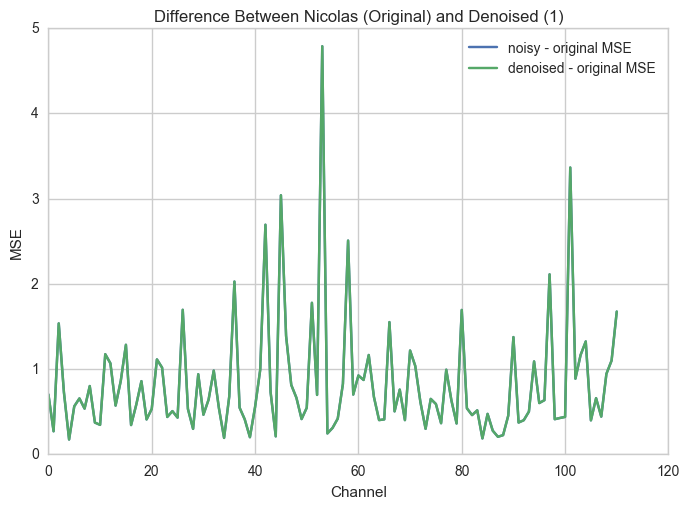

In [3]:
p_global = {'Fs': 500,
            'order': 2,
            'cutoff': .1}
RAW_EEG_NEW = highpass(RAW_EEG_ORIG, {}, p_global)
plot_heat(RAW_EEG[:, ::10], 'Denoised Heatmap, EEG Channels')
plot_heat(np.abs(RAW_EEG_NEW[:, ::10] - RAW_EEG[:, ::10]), 'Abs Diff since last prep. step')
plot_heat(np.log(np.abs(RAW_EEG_NEW[:, ::10] - RAW_EEG[:, ::10])), 'Abs Diff since last prep. step (logscale in z)')
plot_heat(PRE[:, ::10], 'Preprocessed Heatmap')
plot_heat(np.abs(PRE[:, ::10] - RAW_EEG[:, ::10]), 'Abs Diff Pre - Denoised, EEG Channels')
plot_heat(np.log(np.abs(PRE[:, ::10] - RAW_EEG[:, ::10])), 'Abs Diff Pre - Denoised, EEG Channels (log scale in z)')
sparklines(PRE[:, ::50], RAW_EEG[:, ::50], RAW_EEG_NEW[:, ::50], 'Sparklines -- Orig = Nicolas, Noisy = Raw, Denoised = Our Denoised')
plt.show()
chan_errs(PRE, RAW_EEG, RAW_EEG, 'Difference Between Nicolas (Original) and Denoised (1)')
plt.show()

### 2. BandStop Filter from 59 - 61 Hz (for Power Line)

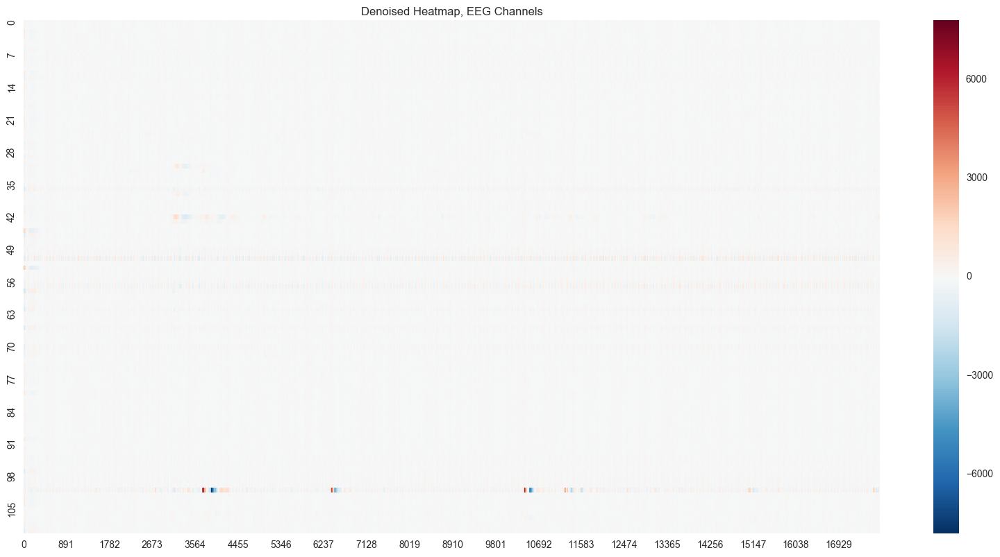

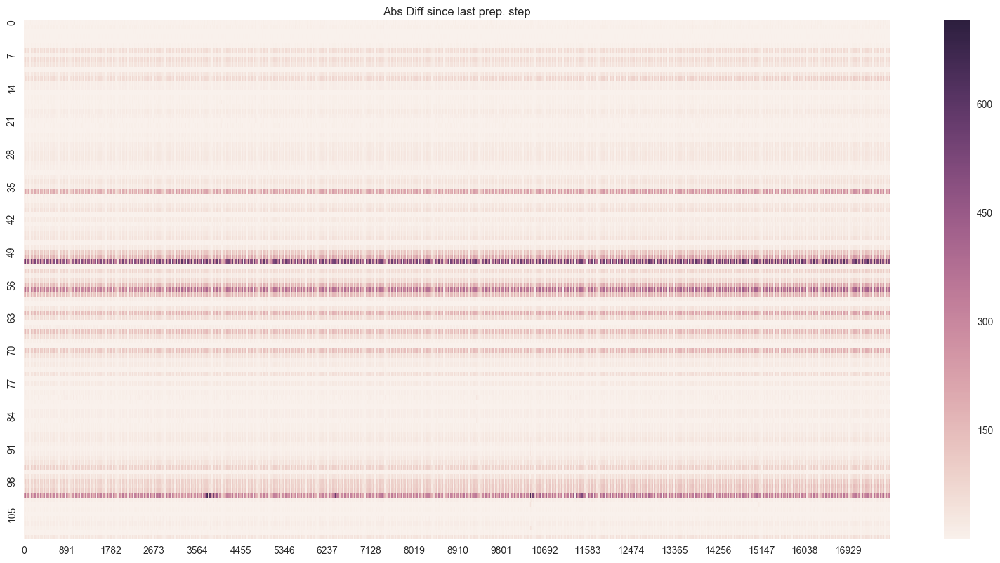

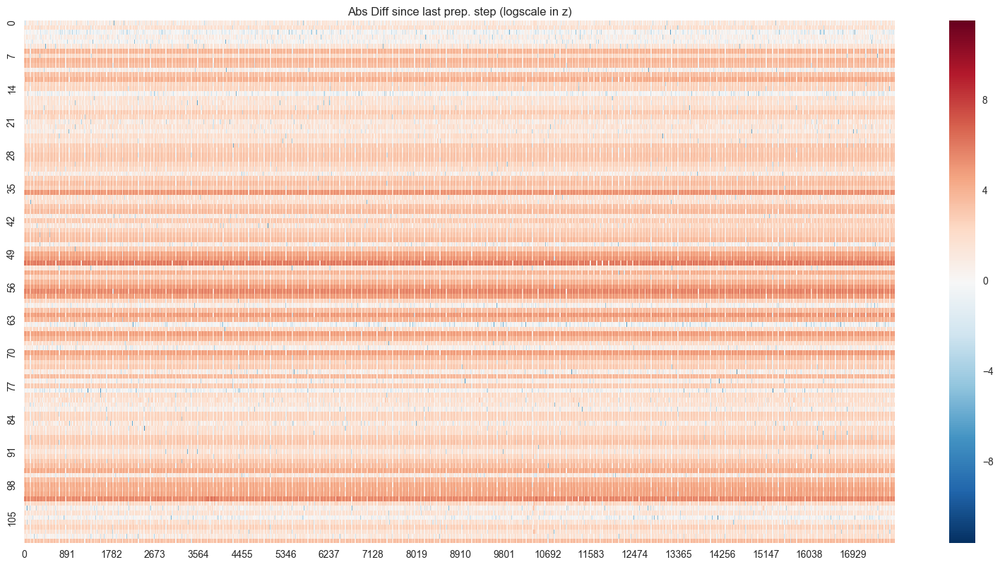

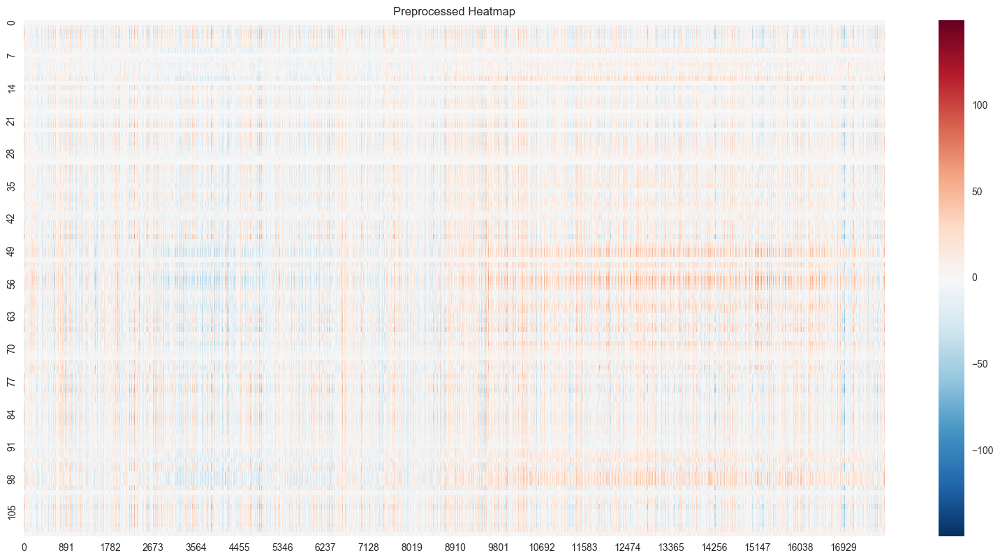

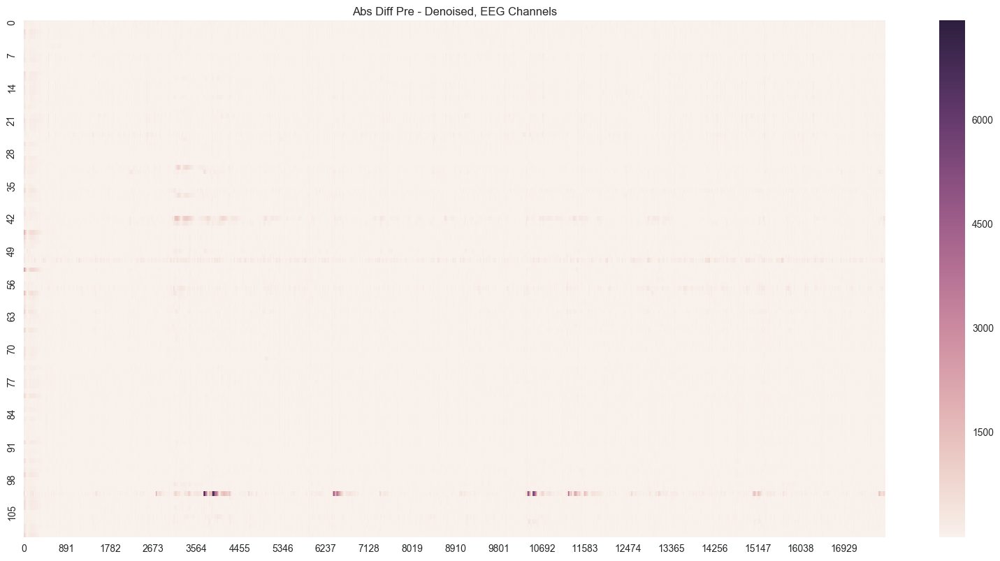

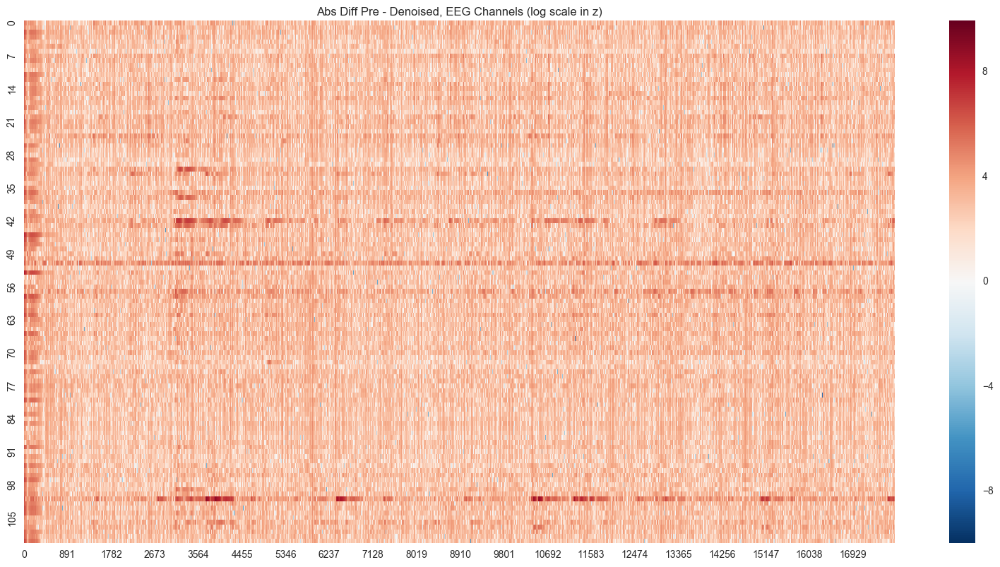

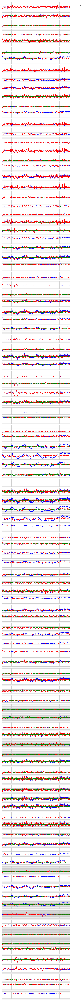

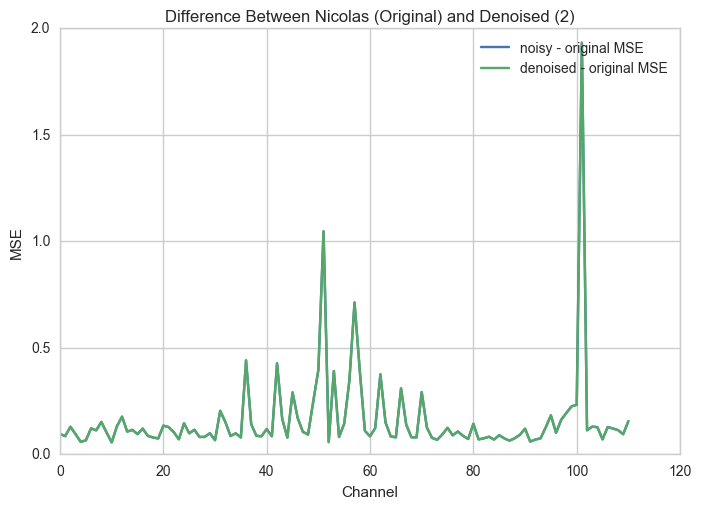

In [4]:
RAW_EEG = RAW_EEG_NEW
p_global = {'Fs': 500,
            'order': 2,
            'cutoff': [59, 61]}
RAW_EEG_NEW = bandstop(RAW_EEG, {}, p_global)
plot_heat(RAW_EEG[:, ::10], 'Denoised Heatmap, EEG Channels')
plot_heat(np.abs(RAW_EEG_NEW[:, ::10] - RAW_EEG[:, ::10]), 'Abs Diff since last prep. step')
plot_heat(np.log(np.abs(RAW_EEG_NEW[:, ::10] - RAW_EEG[:, ::10])), 'Abs Diff since last prep. step (logscale in z)')
plot_heat(PRE[:, ::10], 'Preprocessed Heatmap')
plot_heat(np.abs(PRE[:, ::10] - RAW_EEG_NEW[:, ::10]), 'Abs Diff Pre - Denoised, EEG Channels')
plot_heat(np.log(np.abs(PRE[:, ::10] - RAW_EEG_NEW[:, ::10])), 'Abs Diff Pre - Denoised, EEG Channels (log scale in z)')
sparklines(PRE[:, ::50], RAW_EEG[:, ::50], RAW_EEG_NEW[:, ::50], 'Sparklines -- Orig = Nicolas, Noisy = Raw, Denoised = Our Denoised')
plt.show()
chan_errs(PRE, RAW_EEG, RAW_EEG, 'Difference Between Nicolas (Original) and Denoised (2)')
plt.show()

### 3. EOG Regression

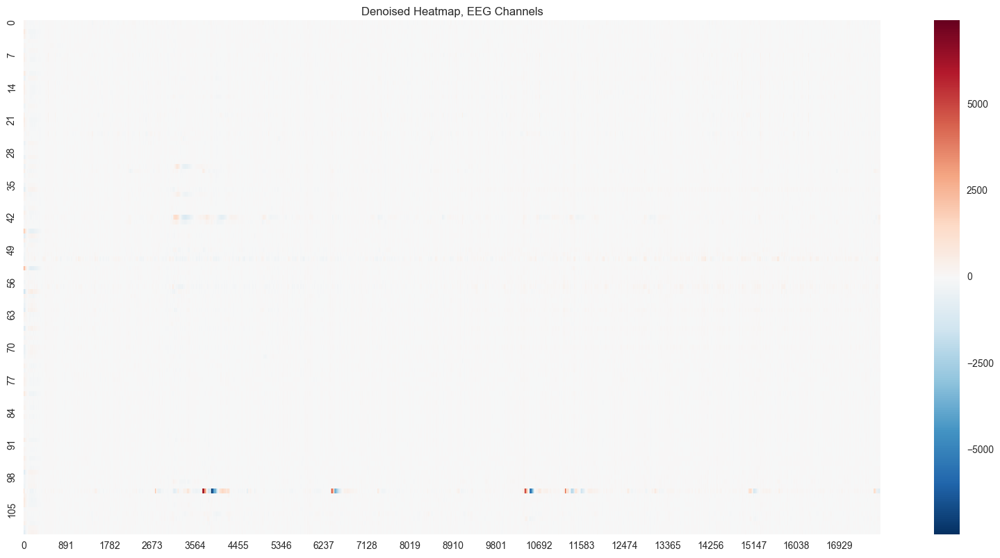

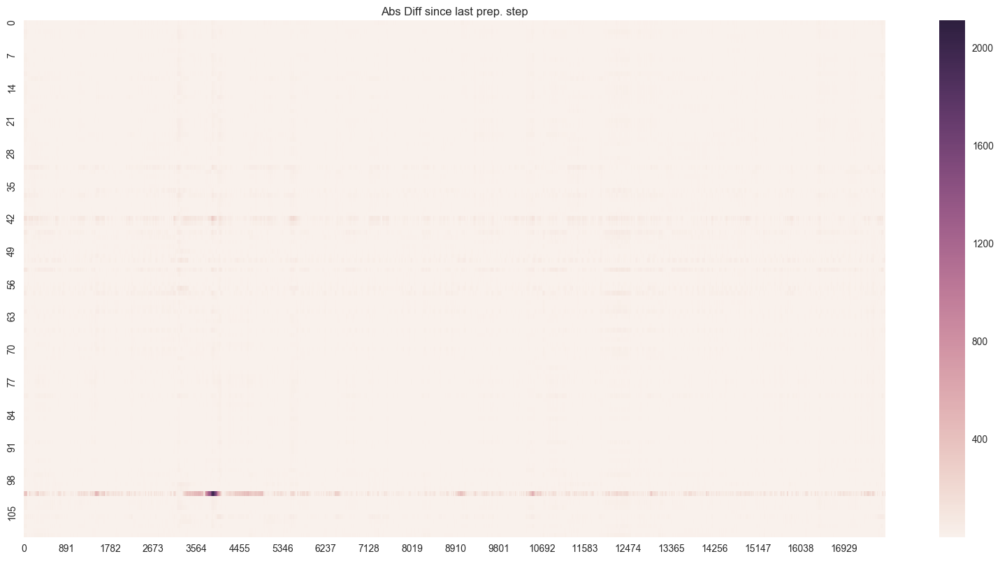

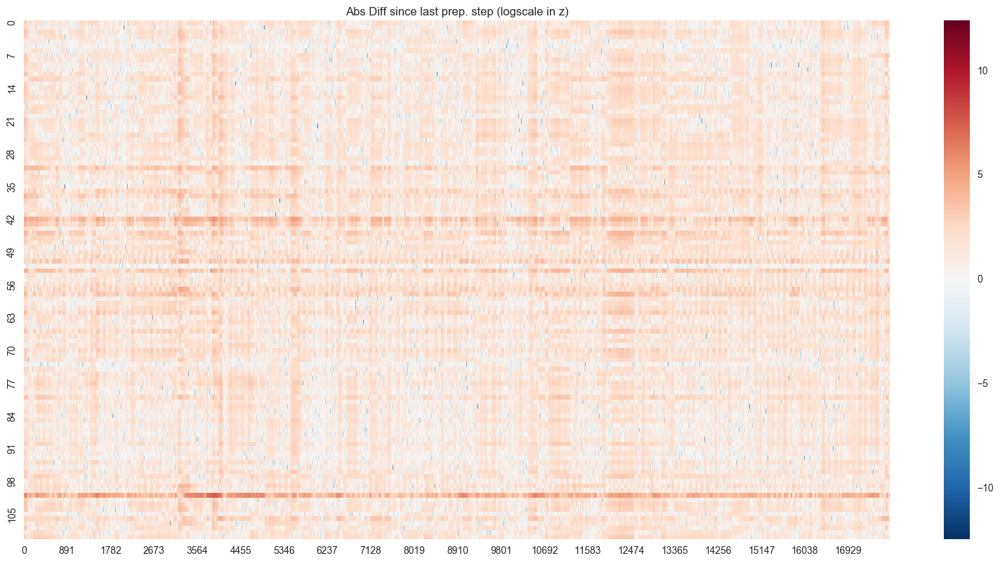

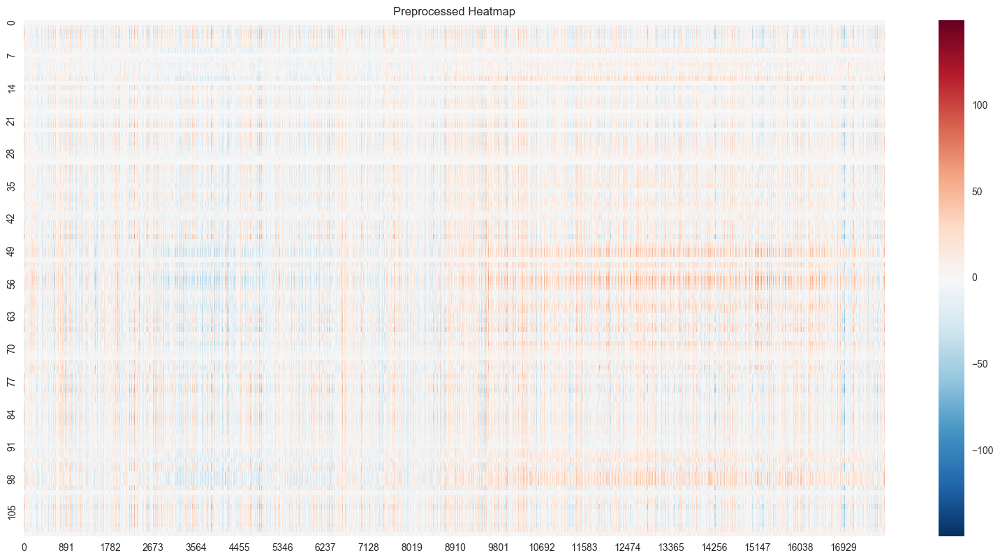

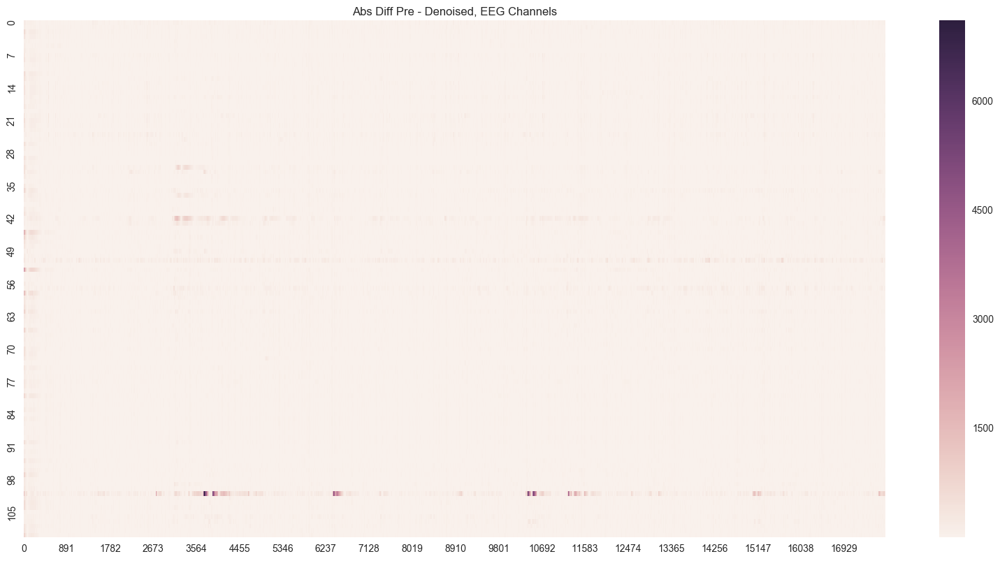

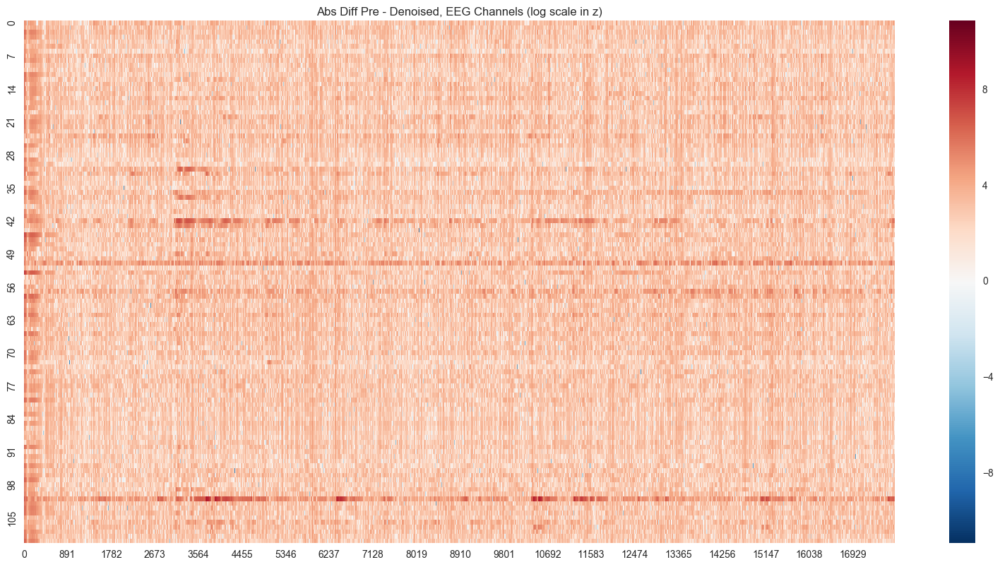

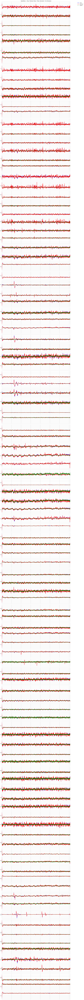

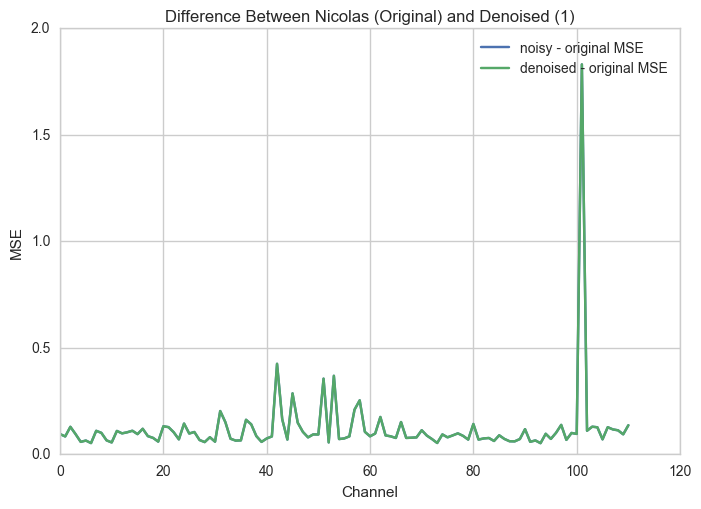

In [5]:
RAW_EEG = RAW_EEG_NEW
RAW_EEG_NEW = eog_regress((RAW_EEG, RAW_EOG), {}, {})
plot_heat(RAW_EEG[:, ::10], 'Denoised Heatmap, EEG Channels')
plot_heat(np.abs(RAW_EEG_NEW[:, ::10] - RAW_EEG[:, ::10]), 'Abs Diff since last prep. step')
plot_heat(np.log(np.abs(RAW_EEG_NEW[:, ::10] - RAW_EEG[:, ::10])), 'Abs Diff since last prep. step (logscale in z)')
plot_heat(PRE[:, ::10], 'Preprocessed Heatmap')
plot_heat(np.abs(PRE[:, ::10] - RAW_EEG_NEW[:, ::10]), 'Abs Diff Pre - Denoised, EEG Channels')
plot_heat(np.log(np.abs(PRE[:, ::10] - RAW_EEG_NEW[:, ::10])), 'Abs Diff Pre - Denoised, EEG Channels (log scale in z)')
sparklines(PRE[:, ::50], RAW_EEG[:, ::50], RAW_EEG_NEW[:, ::50], 'Sparklines -- Orig = Nicolas, Noisy = Raw, Denoised = Our Denoised')
plt.show()
chan_errs(PRE, RAW_EEG, RAW_EEG, 'Difference Between Nicolas (Original) and Denoised (1)')
plt.show()

### 4. RPCA Denoise

In [7]:
RAW_EEG = RAW_EEG_NEW
p_local = {}
method = 'randomized'
max_iter = 20
verbose = True
p_global = {'max_iter': max_iter,
            'verbose': verbose,
            'pca_method': method}
RAW_EEG_NEW = rpca_denoise(RAW_EEG, p_local, p_global)

mu = 0.00836358645006
Iteration 0: error=2.296e-03, rank=111, nnz=2704021, time=1.713e+01
Iteration 1: error=3.810e-05, rank=111, nnz=2789119, time=3.294e+01
Iteration 2: error=2.086e-05, rank=111, nnz=2834706, time=1.829e+01
Iteration 3: error=2.006e-05, rank=111, nnz=2878832, time=1.675e+01
Iteration 4: error=2.002e-05, rank=111, nnz=2922660, time=1.689e+01
Iteration 5: error=2.002e-05, rank=111, nnz=2966898, time=1.685e+01
Iteration 6: error=2.001e-05, rank=111, nnz=3010978, time=1.675e+01
Iteration 7: error=1.999e-05, rank=111, nnz=3055731, time=1.693e+01
Iteration 8: error=1.996e-05, rank=111, nnz=3100094, time=1.762e+01
Iteration 9: error=1.993e-05, rank=111, nnz=3144238, time=1.760e+01
Iteration 10: error=1.989e-05, rank=111, nnz=3188258, time=1.679e+01
Iteration 11: error=1.983e-05, rank=111, nnz=3232257, time=1.687e+01
Iteration 12: error=1.977e-05, rank=111, nnz=3276206, time=1.681e+01
Iteration 13: error=1.971e-05, rank=111, nnz=3320042, time=1.698e+01
Iteration 14: error=1.

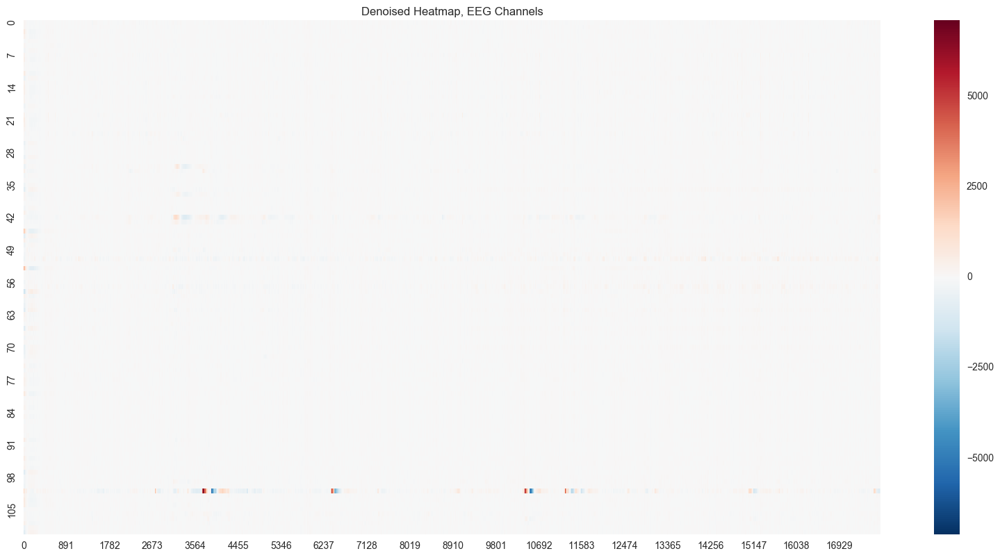

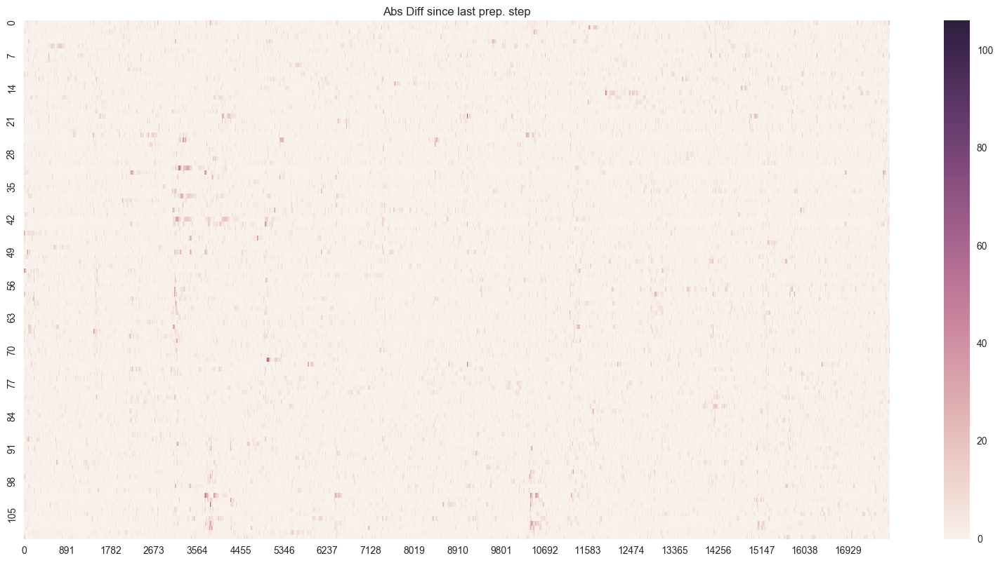

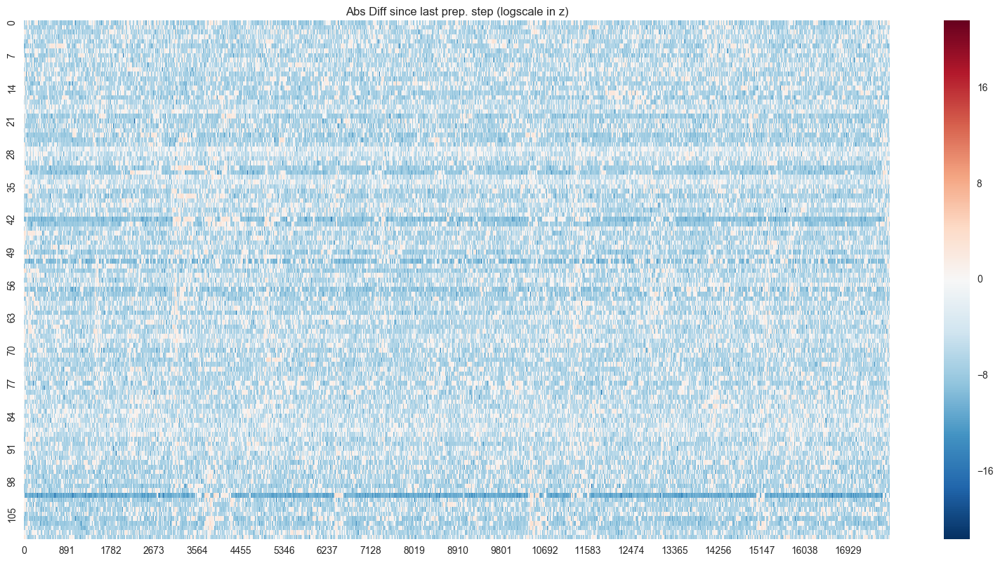

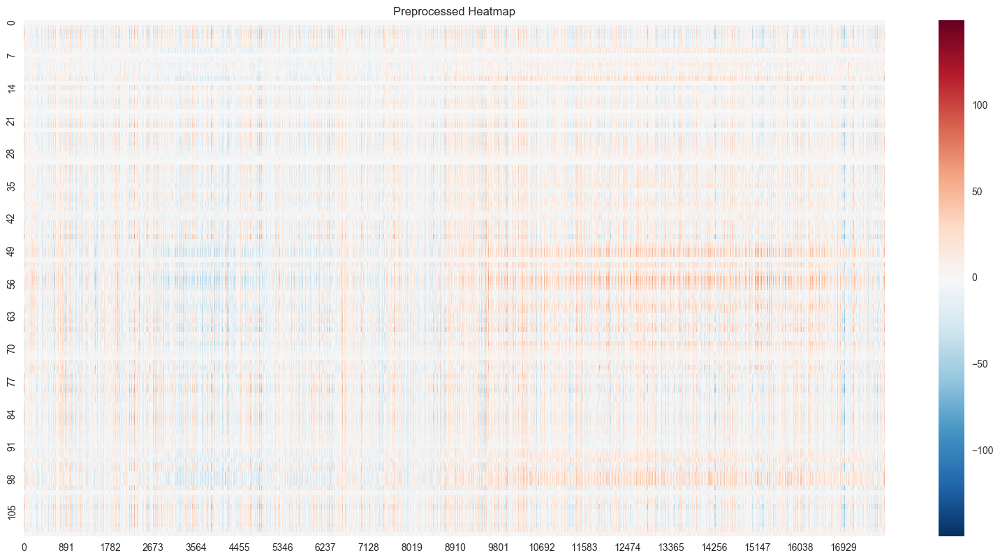

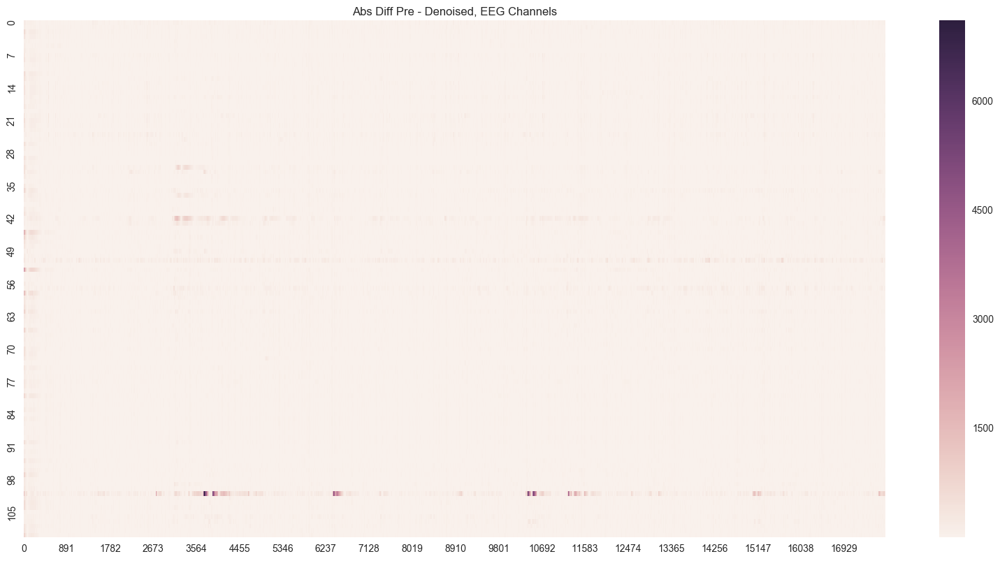

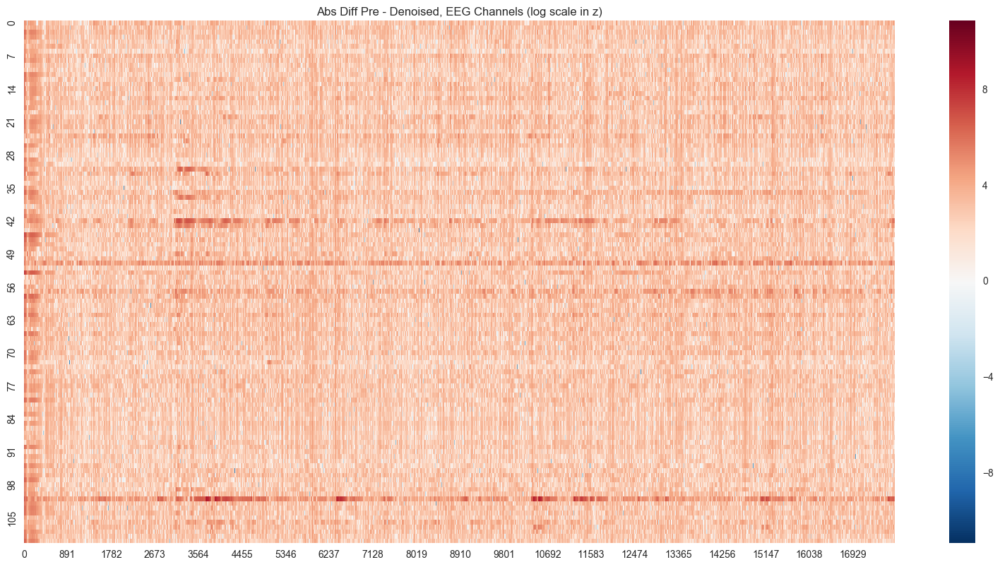

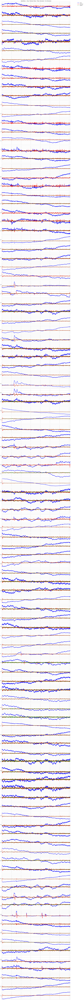

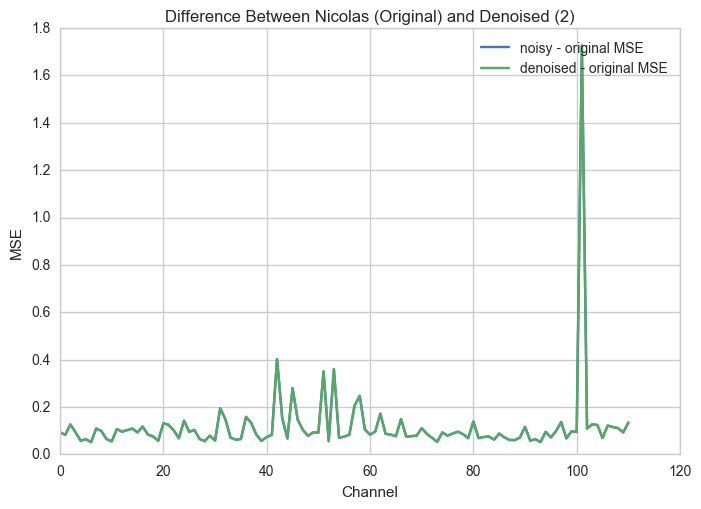

In [8]:
plot_heat(RAW_EEG[:, ::10], 'Denoised Heatmap, EEG Channels')
plot_heat(np.abs(RAW_EEG_NEW[:, ::10] - RAW_EEG[:, ::10]), 'Abs Diff since last prep. step')
plot_heat(np.log(np.abs(RAW_EEG_NEW[:, ::10] - RAW_EEG[:, ::10])), 'Abs Diff since last prep. step (logscale in z)')
plot_heat(PRE[:, ::10], 'Preprocessed Heatmap')
plot_heat(np.abs(PRE[:, ::10] - RAW_EEG[:, ::10]), 'Abs Diff Pre - Denoised, EEG Channels')
plot_heat(np.log(np.abs(PRE[:, ::10] - RAW_EEG[:, ::10])), 'Abs Diff Pre - Denoised, EEG Channels (log scale in z)')
sparklines(PRE[:, ::50], RAW_EEG_ORIG[:, ::50], RAW_EEG[:, ::50], 'Sparklines -- Orig = Nicolas, Noisy = Raw, Denoised = Our Denoised')
plt.show()
chan_errs(PRE, RAW_EEG, RAW_EEG, 'Difference Between Nicolas (Original) and Denoised (2)')
plt.show()